In [1]:
from IPython.display import display, HTML, Image
display(HTML("<style>.container { width:95% !important; }</style>"))

%load_ext autoreload
%autoreload 2

import os
import numpy as np
import pandas as pd
import scanpy as sc

from matplotlib import cm
import matplotlib.pyplot as plt

import sys
sys.path.append("../../lib")
from stpalette import palette1
from plots import plotSpatialAll
from sankey import makeSankeyDiagram, getCountsDataframe

In [2]:
model = 'WM4237'

In [3]:
preprocessedStDataPath = 'c:/Projects/A_ST/from HPCC 11 28 2022/results_NF1-nod-t2t-k35/%s/' % model
preprocessedDataPath = 'c:/Projects/A_ST/from HPCC 11 28 2022/results_NF2/%s_ST/' % model
dataPath = '../../data/'

ids = sorted(np.loadtxt(dataPath + 'ids_%s_ST.txt' % model, dtype=str))
ids

['WM4237_T0_S1_ST',
 'WM4237_T0_S2_ST',
 'WM4237_T1_S1_ST',
 'WM4237_T1_S2_ST',
 'WM4237_T2_S1_ST',
 'WM4237_T2_S2_ST',
 'WM4237_T3_S1_ST',
 'WM4237_T3_S2_ST',
 'WM4237_T4_S1_ST',
 'WM4237_T4_S2_ST',
 'WM4237_TC_S1_ST',
 'WM4237_TC_S2_ST',
 'WM4237_TE_S1_ST',
 'WM4237_TE_S2_ST',
 'WM4237_TE_S3_ST',
 'WM4237_TE_S4_ST']

In [8]:
if False:
    samplePath = preprocessedDataPath + 'WM4237_TC_S2_ST/'
    df_inception = pd.read_csv(samplePath + 'inception/inception_features.tsv.gz', index_col=0, header=0).sort_index() 
    df_hovernet = pd.read_csv(samplePath + 'hovernet/per_spot_data.csv', index_col=0, header=0).sort_index().reindex(df_inception.index)
    df = pd.concat([df_inception, df_hovernet], axis=1, sort=False)
    df.index.name = 'id'    
    df.to_csv(samplePath + 'data.csv.gz')

# Load imaging data

In [9]:
ads = dict()
for sample in ids[:]:
    print(sample)
    df_temp = pd.read_csv(preprocessedDataPath + '%s/data.csv.gz' % sample, index_col=[0,1]).xs(1, level='in_tissue')
    df_temp.insert(0, 'original_barcode', df_temp.index.values)
    ads.update({sample: sc.AnnData(X=df_temp.loc[:, df_temp.columns.str.contains('feat')],
                                   obs=df_temp.loc[:, ~df_temp.columns.str.contains('feat')])})
    
ad_im_all = sc.concat(ads, label='sample', join='outer', index_unique ='-')
ad_im_all

WM4237_T0_S1_ST
WM4237_T0_S2_ST
WM4237_T1_S1_ST
WM4237_T1_S2_ST
WM4237_T2_S1_ST
WM4237_T2_S2_ST
WM4237_T3_S1_ST
WM4237_T3_S2_ST
WM4237_T4_S1_ST
WM4237_T4_S2_ST
WM4237_TC_S1_ST
WM4237_TC_S2_ST
WM4237_TE_S1_ST
WM4237_TE_S2_ST
WM4237_TE_S3_ST
WM4237_TE_S4_ST


AnnData object with n_obs × n_vars = 19910 × 2048
    obs: 'original_barcode', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'pxl_row_in_wsi', 'pxl_col_in_wsi', 'density_connective', 'density_inflammatory', 'density_necrosis', 'density_neoplasia', 'density_no_label', 'density_no_neoplasia', 'count_connective', 'count_inflammatory', 'count_necrosis', 'count_neoplasia', 'count_no_label', 'count_no_neoplasia', 'total_count', 'average_perimeter_length_neoplasia', 'average_perimeter_length_no_label', 'average_perimeter_length_connective', 'average_perimeter_length_inflammatory', 'average_perimeter_length_necrosis', 'average_perimeter_length_no_neoplasia', 'average_perimeter_length', 'std_perimeter_length', 'average_area_neoplasia', 'average_area_no_label', 'average_area_connective', 'average_area_inflammatory', 'average_area_necrosis', 'average_area_no_neoplasia', 'average_area', 'std_area', 'average_orientation_neoplasia', 'average_orientation_no_label', 'average_or

# Inception features UMAP and clustering

In [10]:
sc.pp.pca(ad_im_all, n_comps=30, zero_center=True, use_highly_variable=False)

C:\Users\domans\Anaconda3\lib\site-packages\anndata\_core\anndata.py:1220: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'original_barcode' as categorical


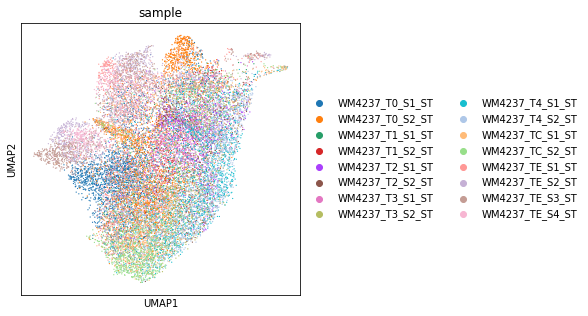

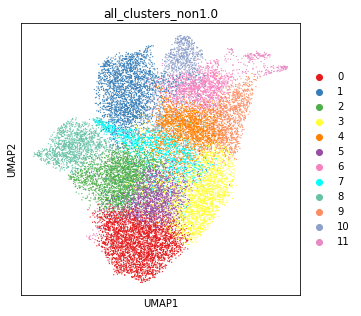

In [12]:
sc.pp.neighbors(ad_im_all, use_rep='X_pca')
sc.tl.umap(ad_im_all)

pref = 'non'
res_im = 1.0

sc.tl.leiden(ad_im_all, key_added='all_clusters_%s%s' % (pref, res_im), resolution=res_im)

plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(ad_im_all, color=['sample'])
sc.pl.umap(ad_im_all, color=['all_clusters_%s%s' % (pref, res_im)], palette=palette1)

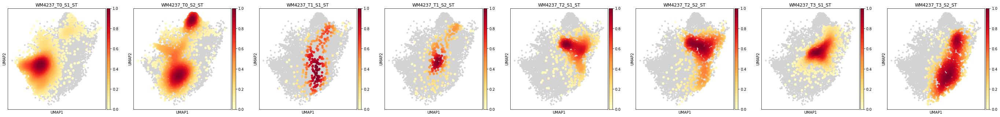

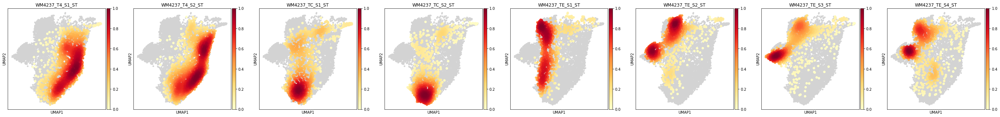

In [13]:
split = 8

identity = 'sample'
ad_part = ad_im_all[ad_im_all.obs[identity].isin(ids[:split]), :].copy()
ad_part.X = None
sc.tl.embedding_density(ad_part, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_part, groupby=identity, ncols=split)
ad_part = ad_im_all[ad_im_all.obs[identity].isin(ids[split:]), :].copy()
ad_part.X = None
sc.tl.embedding_density(ad_part, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_part, groupby=identity, ncols=split)

In [14]:
makeSankeyDiagram(getCountsDataframe(ad_im_all.obs['all_clusters_%s%s' % (pref, res_im)], ad_im_all.obs['sample']), border=25)

Cannot save static image (likely due to missing orca). Saving to interactive html


# Spatial layout

In [15]:
images = {id: [(ad_temp := sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id)).uns['spatial'], ad_temp.obs.index, ad_temp.obsm['spatial']] for id in ids}

ads = dict()
for sample in ids:
    ads[sample] = ad_im_all[ad_im_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample][0]
    ads[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads[sample].obs['original_barcode']).values

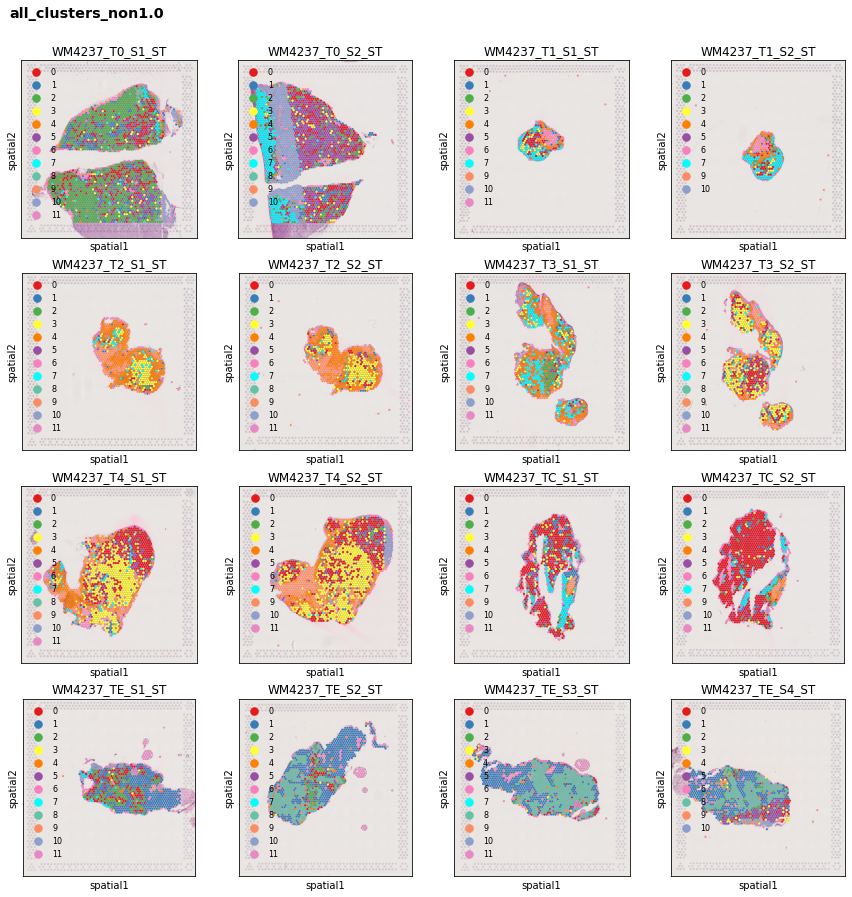

In [17]:
plotSpatialAll(ads, identity = 'all_clusters_%s%s' % (pref, res_im), palette=palette1, nx=4, ny=4)

# Annotate artifacts

WM4237_T0_S1_ST


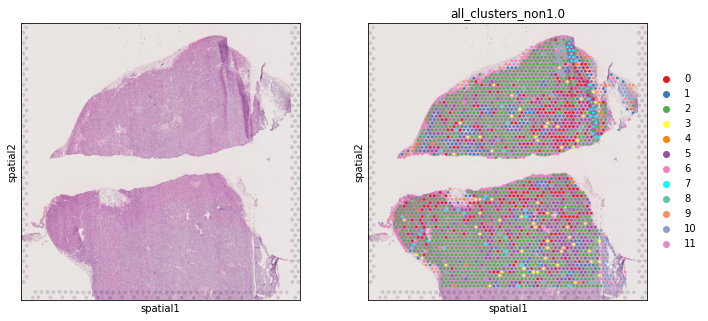

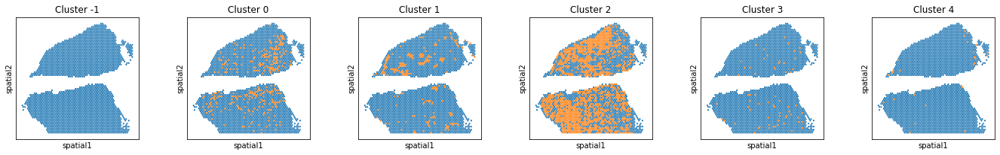

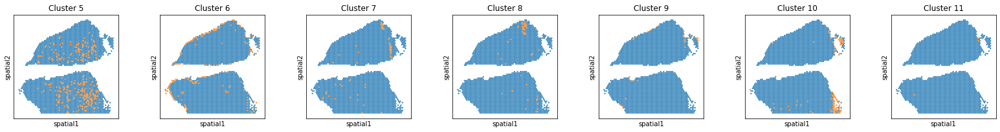

WM4237_T0_S2_ST


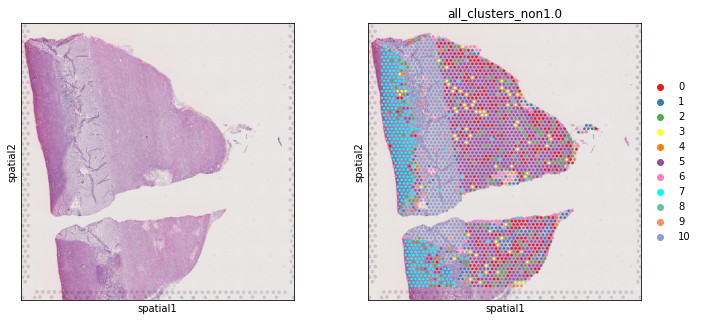

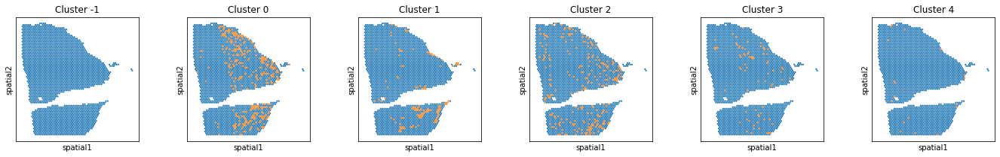

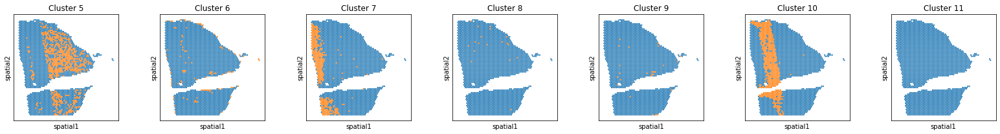

WM4237_T1_S1_ST


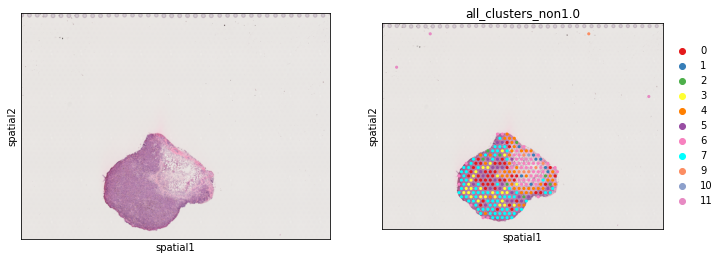

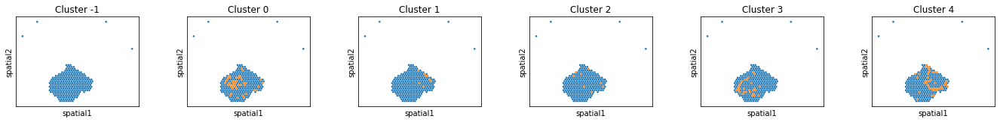

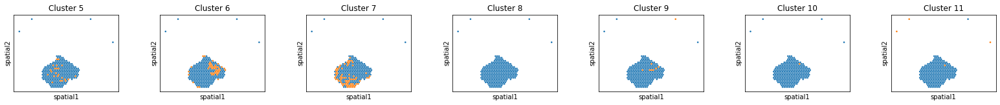

WM4237_T1_S2_ST


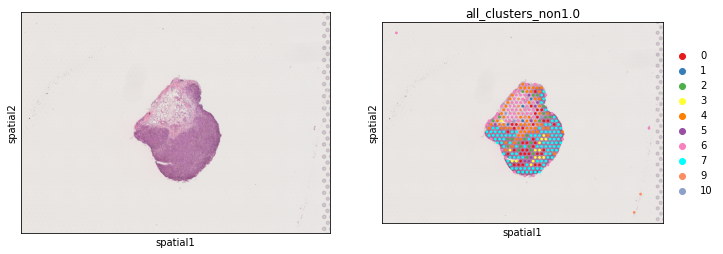

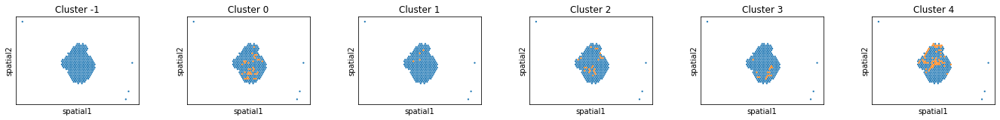

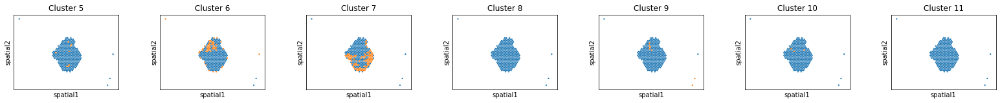

WM4237_T2_S1_ST


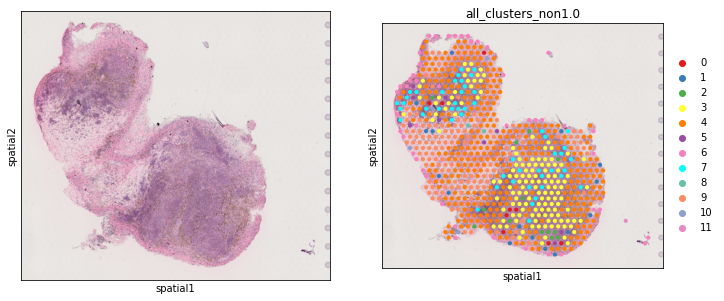

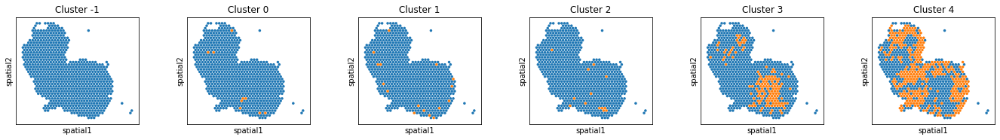

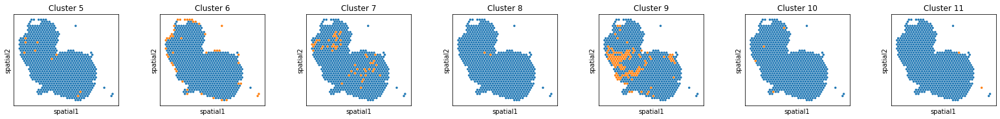

WM4237_T2_S2_ST


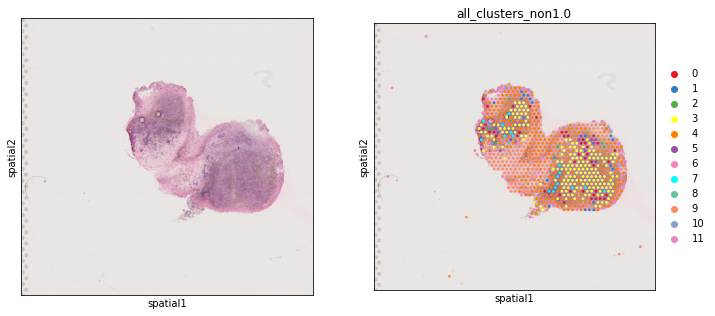

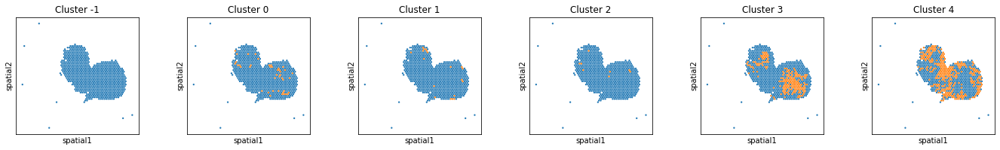

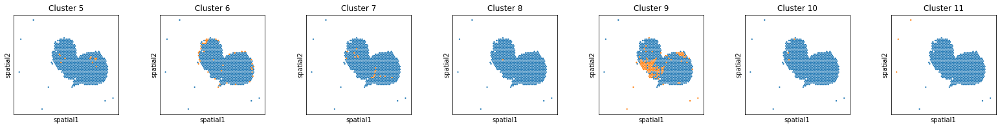

WM4237_T3_S1_ST


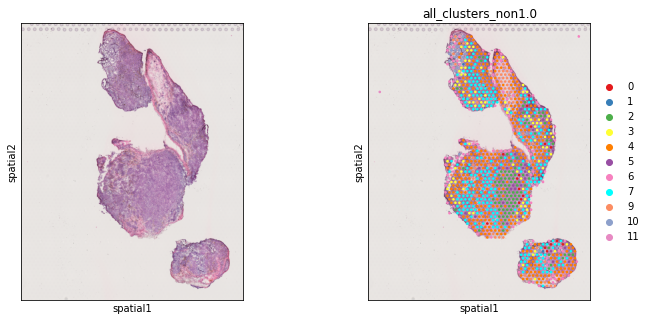

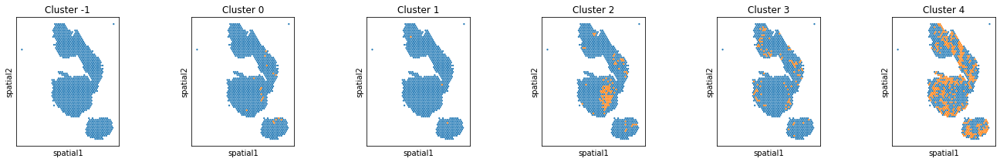

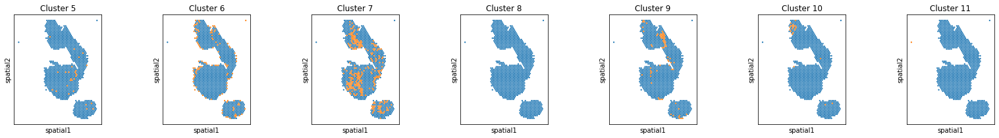

WM4237_T3_S2_ST


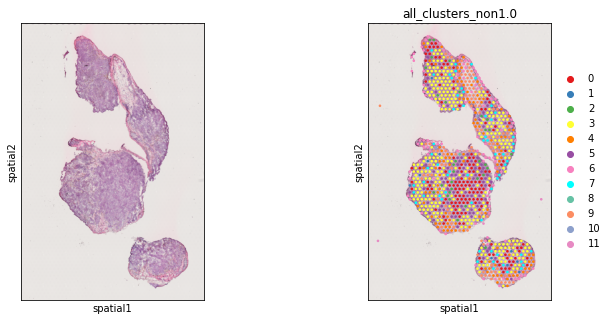

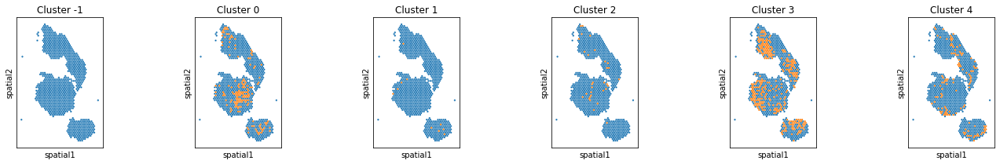

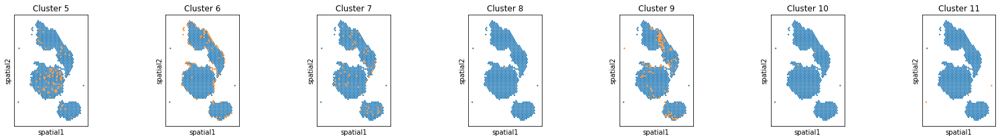

WM4237_T4_S1_ST


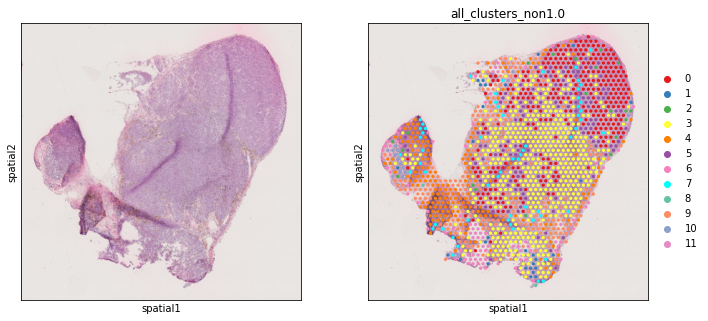

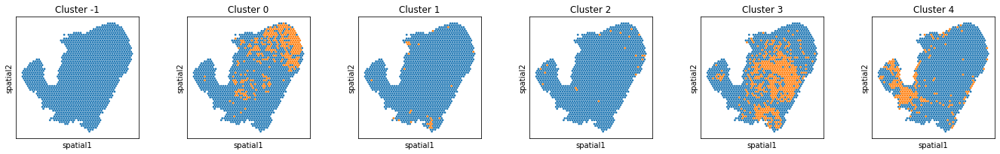

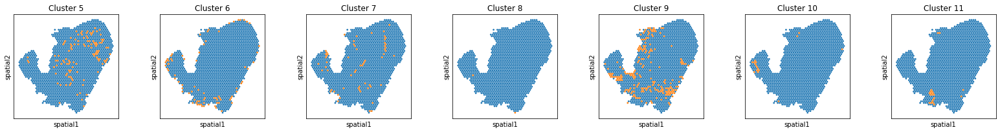

WM4237_T4_S2_ST


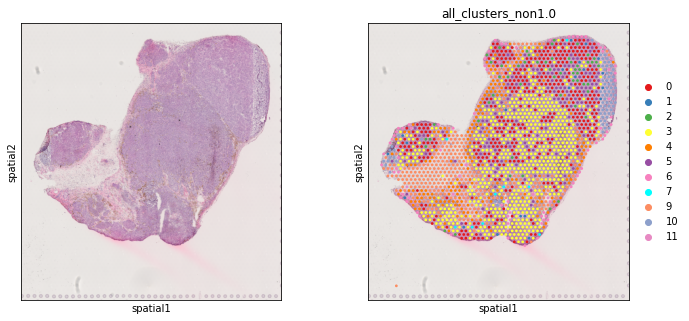

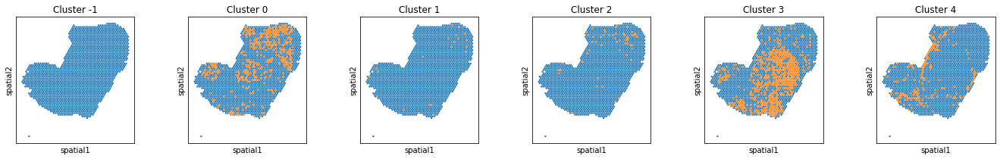

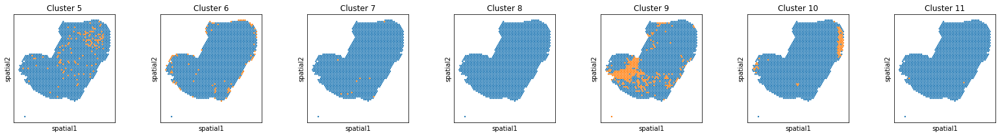

WM4237_TC_S1_ST


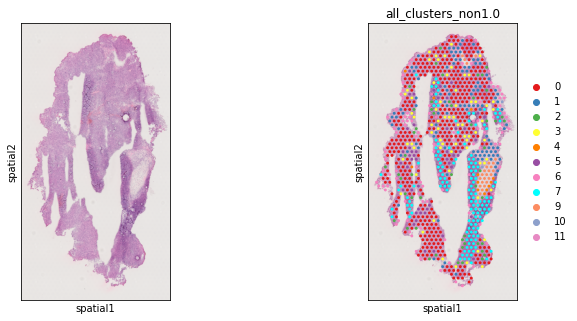

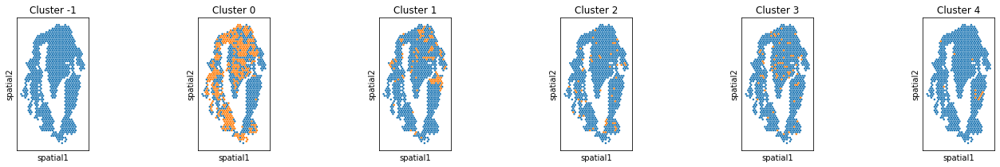

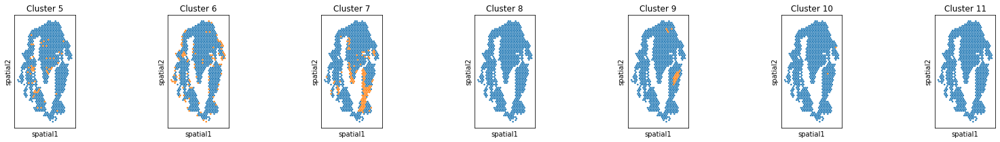

WM4237_TC_S2_ST


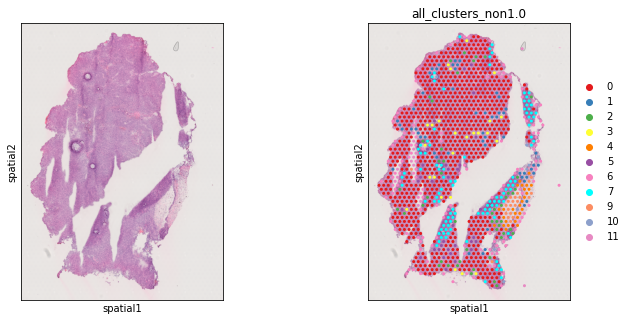

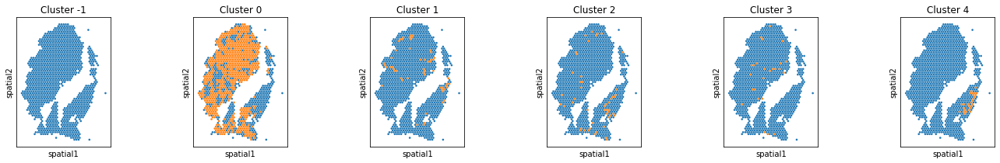

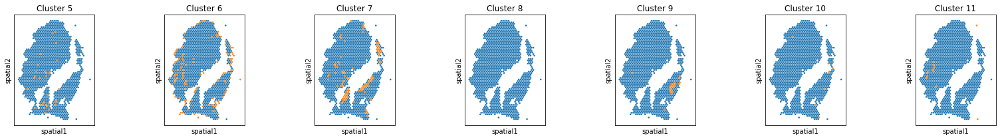

WM4237_TE_S1_ST


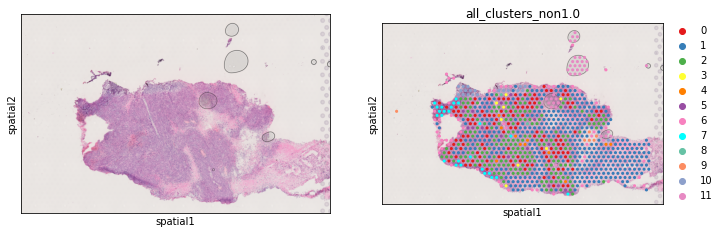

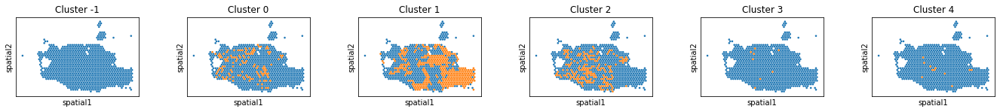

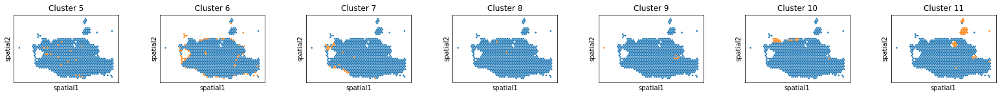

WM4237_TE_S2_ST


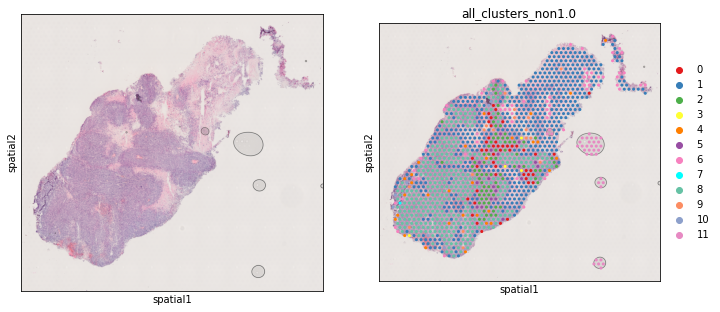

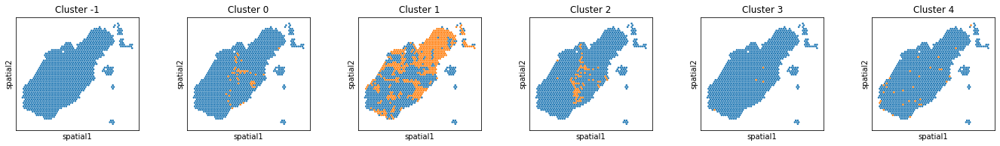

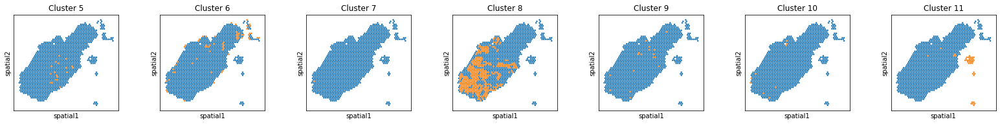

WM4237_TE_S3_ST


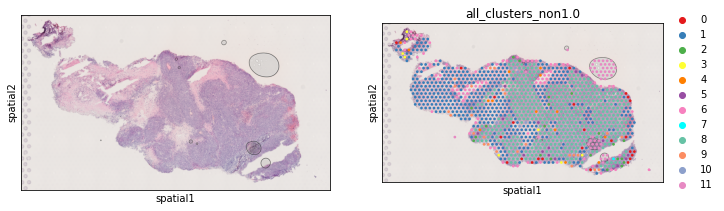

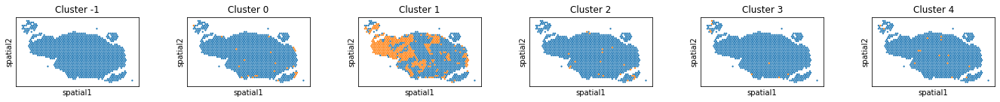

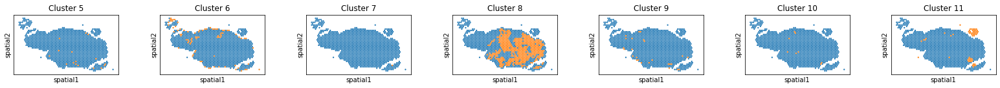

WM4237_TE_S4_ST


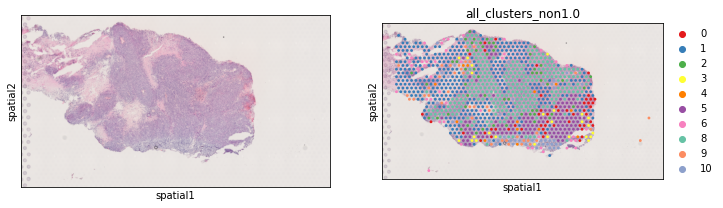

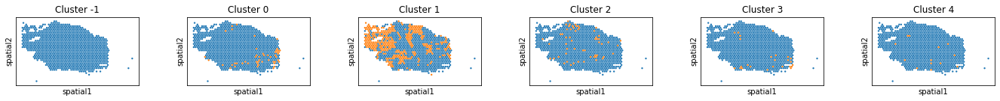

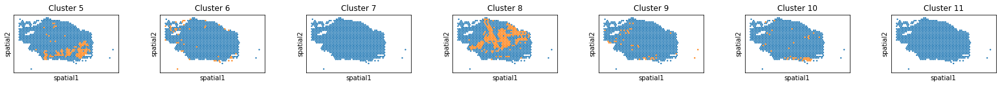

In [18]:
for sample in ids:
    print(sample)
    
    plt.rcParams["figure.figsize"] = (5,5)
    sc.pl.spatial(ads[sample], img_key="hires", color=[None, 'all_clusters_%s%s' % (pref, res_im)])
    
    plt.rcParams["figure.figsize"] = (3,3)
    for g in list(range(-1, 5)), list(range(5, 12)):
        for i in g:
            ads[sample].obs['Cluster %s' % i] = (ads[sample].obs['all_clusters_%s%s' % (pref, res_im)]==str(i)).astype('category')
        sc.pl.spatial(ads[sample], img_key=None, color=['Cluster %s' % i for i in g], ncols=8, legend_loc='on data 2', spot_size=425)

In [22]:
# 10 folds
# 11 bubbles

ad_im_all.obs['is_artifact'] = ad_im_all.obs['all_clusters_%s%s' % (pref, res_im)].isin(['10', '11'])
print(ad_im_all.obs['is_artifact'].value_counts())

df_index_filtered_with_inception_features = ad_im_all.obs[['original_barcode', 'sample', 'all_clusters_%s%s' % (pref, res_im), 'is_artifact']]
df_index_filtered_with_inception_features.to_csv(dataPath + 'df_index_filtered_with_inception_features_%s.csv' % model)

False    18815
True      1095
Name: is_artifact, dtype: int64


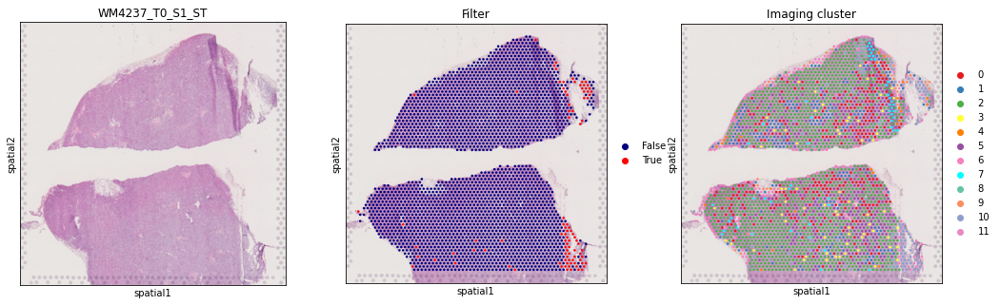

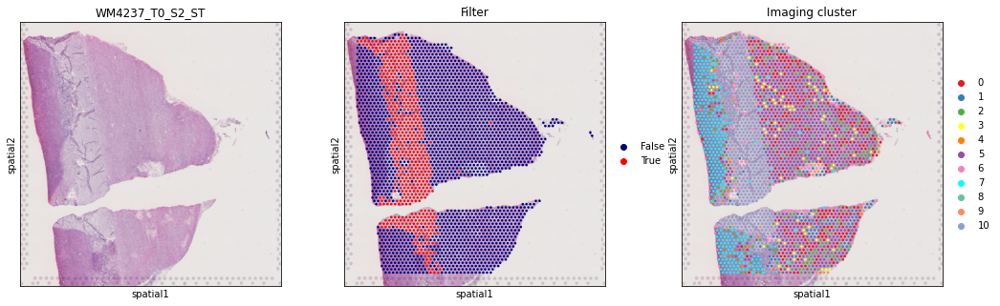

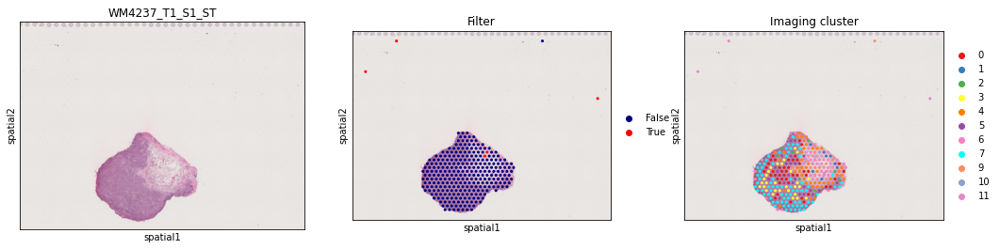

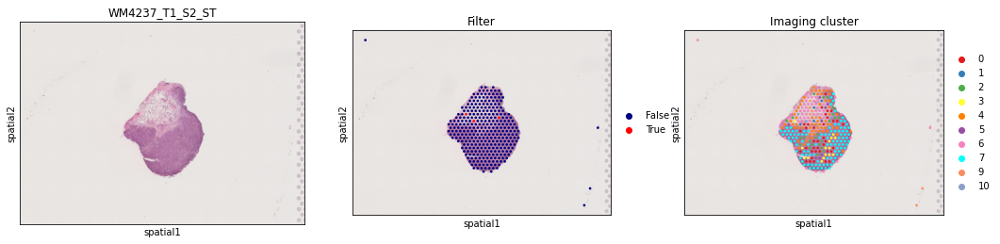

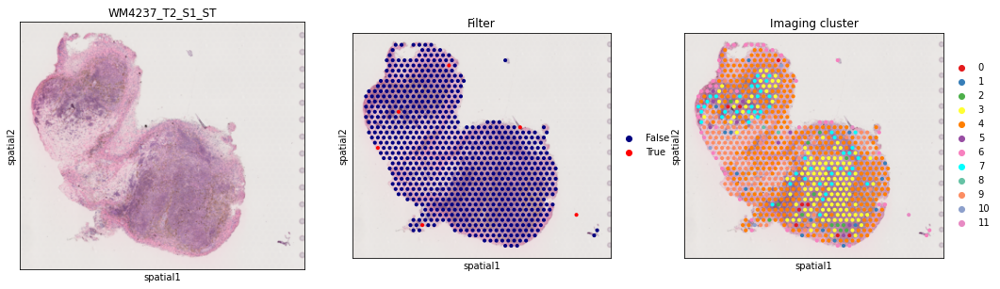

...

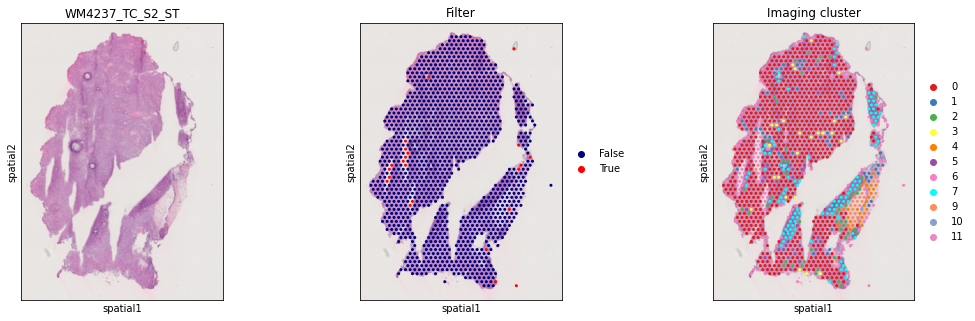

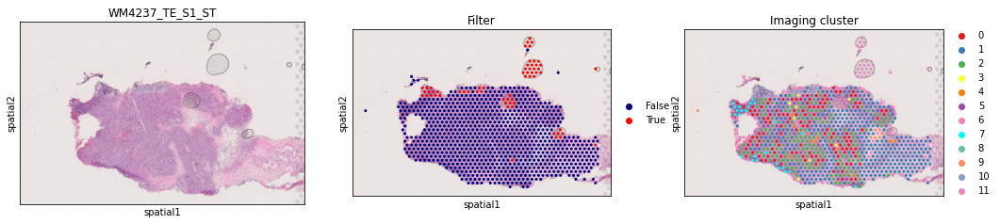

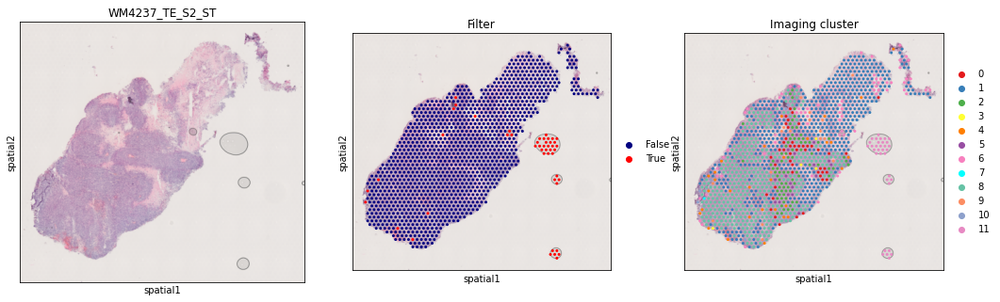

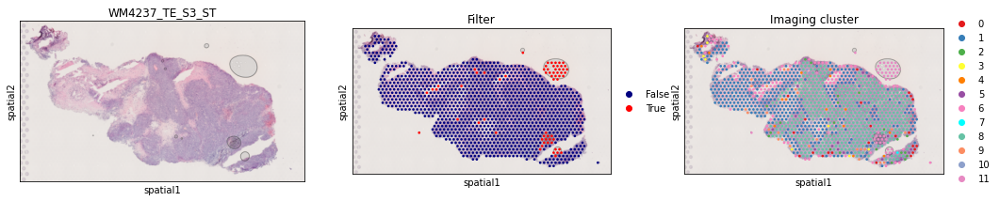

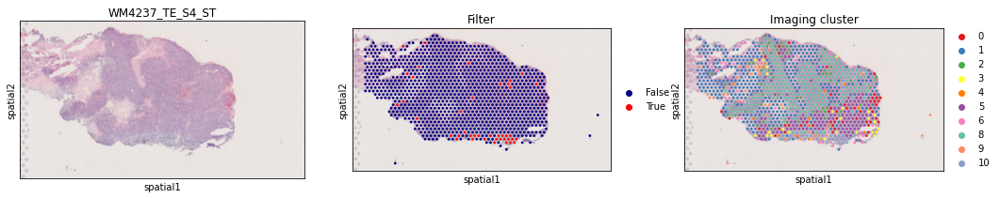

In [23]:
palette1.update({'True': 'red', 'False': 'navy'})

plt.rcParams["figure.figsize"] = (5,5)
    
for sample in ids:
    ads[sample].obs['is_artifact'] = ad_im_all[ad_im_all.obs['sample']==sample, :].obs['is_artifact'].astype(str).astype('category')
    sc.pl.spatial(ads[sample], img_key="lowres", color=[None, 'is_artifact', 'all_clusters_%s%s' % (pref, res_im)], palette=palette1, title=[sample, 'Filter', 'Imaging cluster'])    

# Filter and plot hovernet quantities

In [24]:
ad_im_all = ad_im_all[~ad_im_all.obs['is_artifact'], :]
ad_im_all.shape

(18815, 2048)

In [25]:
images = {id: [(ad_temp := sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id)).uns['spatial'], ad_temp.obs.index, ad_temp.obsm['spatial']] for id in ids}

ads = dict()
for sample in ids:
    ads[sample] = ad_im_all[ad_im_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample][0]
    ads[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads[sample].obs['original_barcode']).values

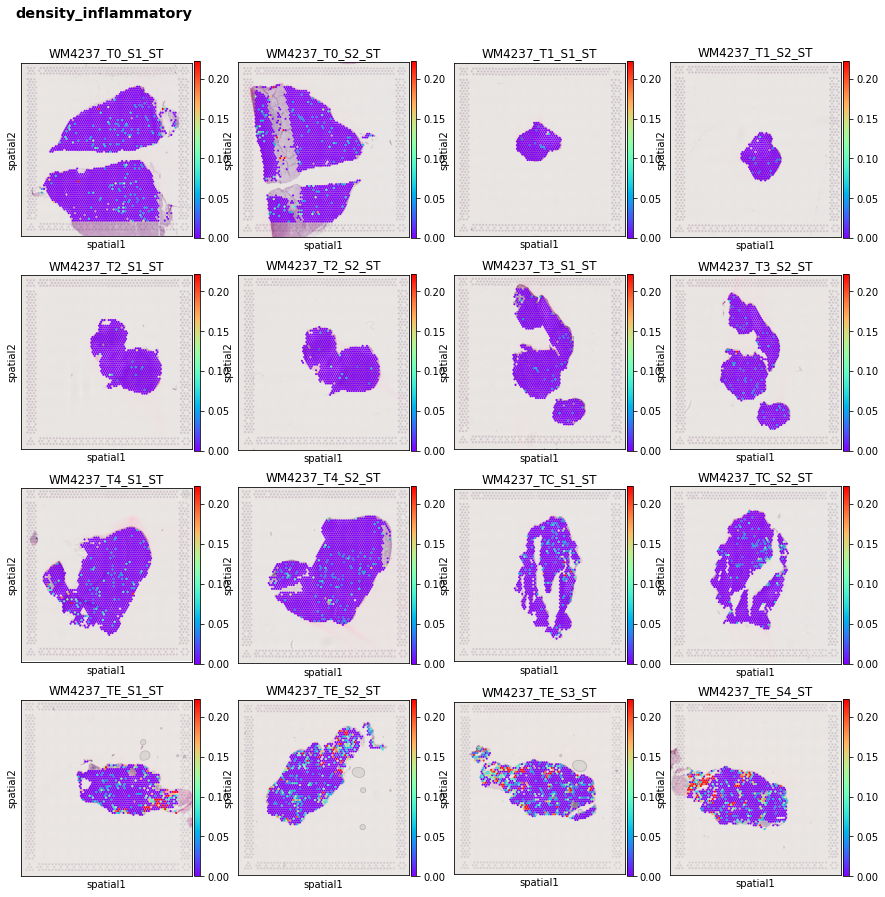

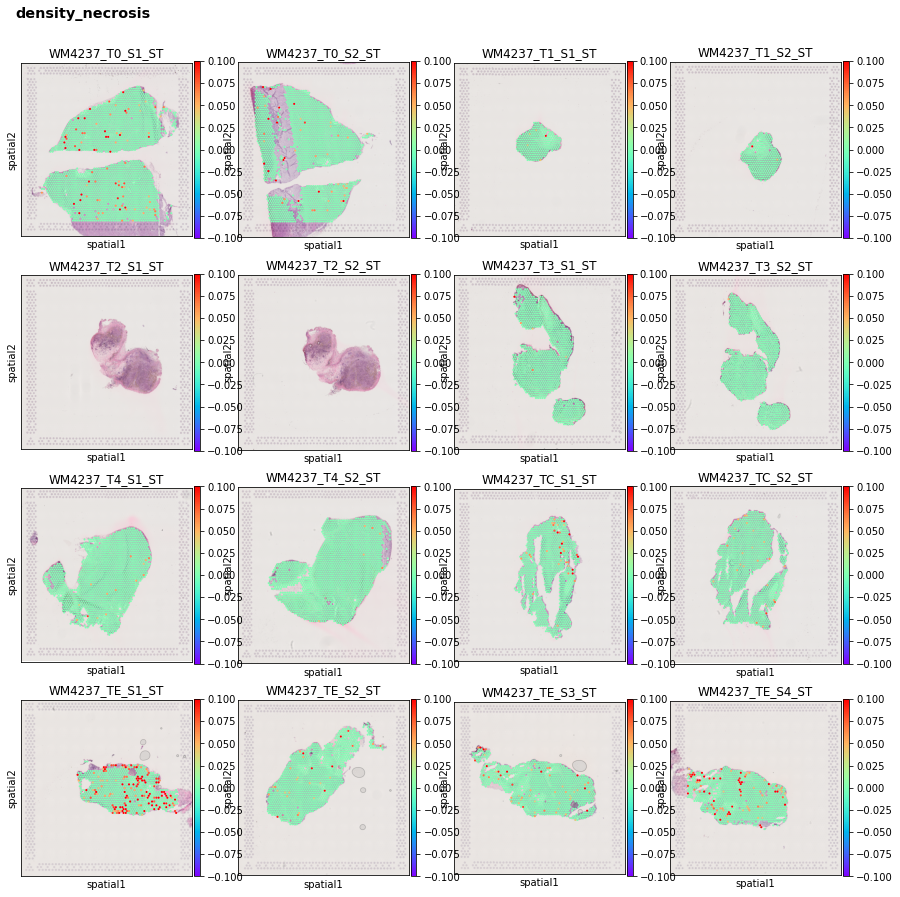

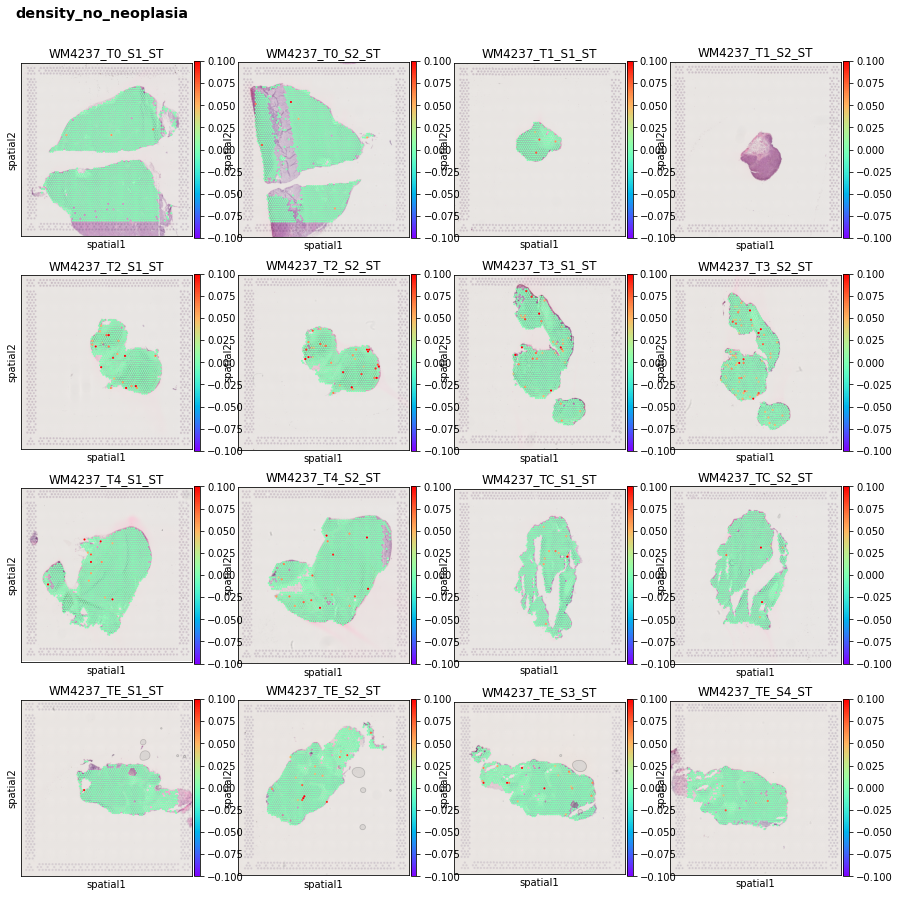

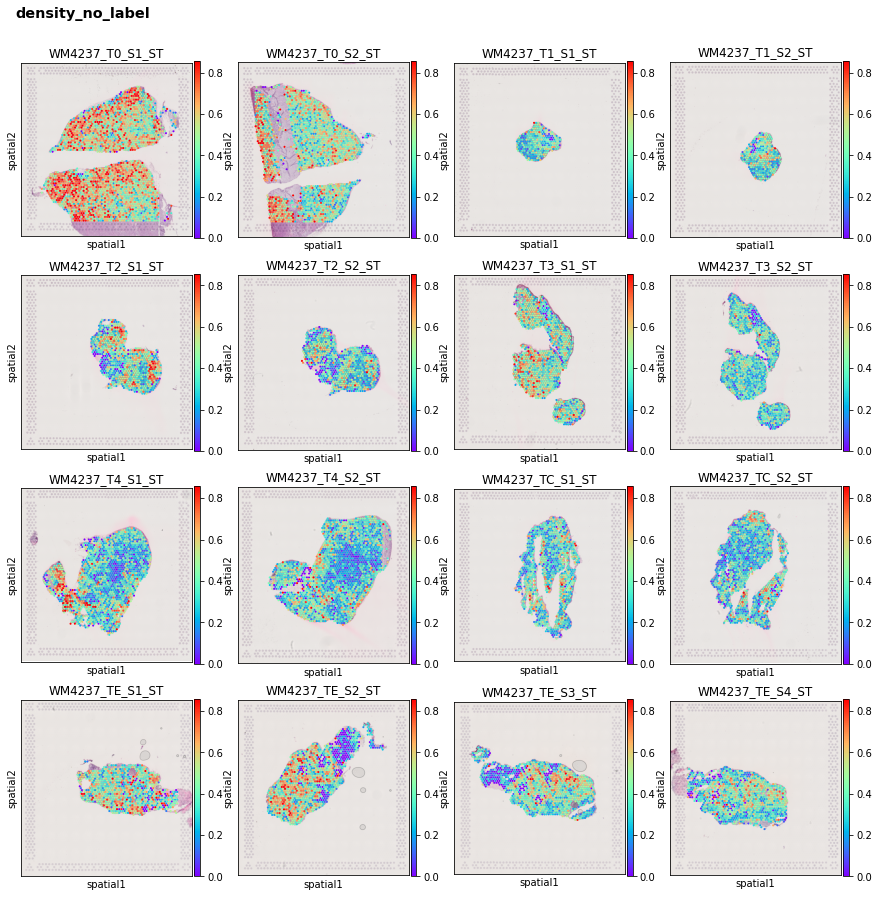

In [26]:
# Confirm that the 4 classes are not useful
for identity in ['density_inflammatory', 'density_necrosis', 'density_no_neoplasia', 'density_no_label']:
    plotSpatialAll(ads, identity = identity, nx=4, ny=4)

In [27]:
cols = ad_im_all.obs.columns

condition1 = np.any([cols.str.startswith(c) for c in ['density', 'count', 'average', 'std', 'total']], axis=0)
condition2 = np.any([cols.str.contains(c) for c in ['inflammatory', 'no_neoplasia', 'necrosis', 'no_label', 'cell_type_prob', 'count_']], axis=0)

cols = cols[condition1 & ~condition2]
print(len(cols))

19


In [28]:
for sample in ids:
    for q in ['area', 'perimeter_length', 'eccentricity']:
        ads[sample].obs['cov_%s' % q] = ads[sample].obs['std_%s' % q] / ads[sample].obs['average_%s' % q]

Index(['density_connective', 'density_neoplasia', 'total_count'], dtype='object')


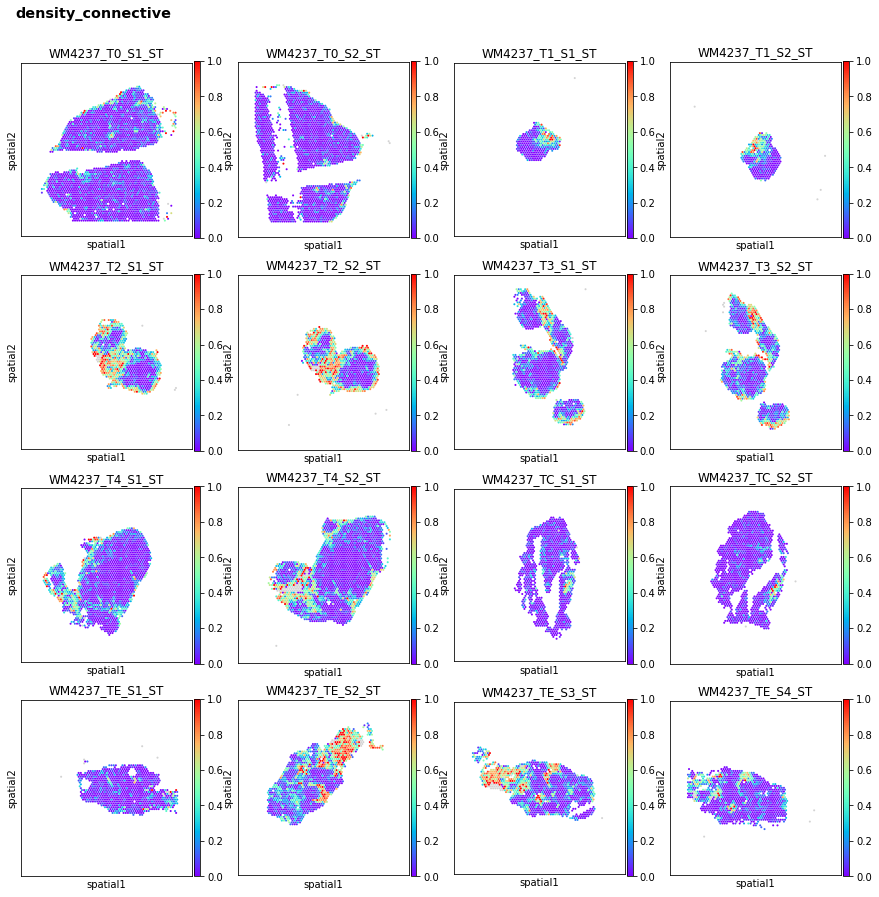

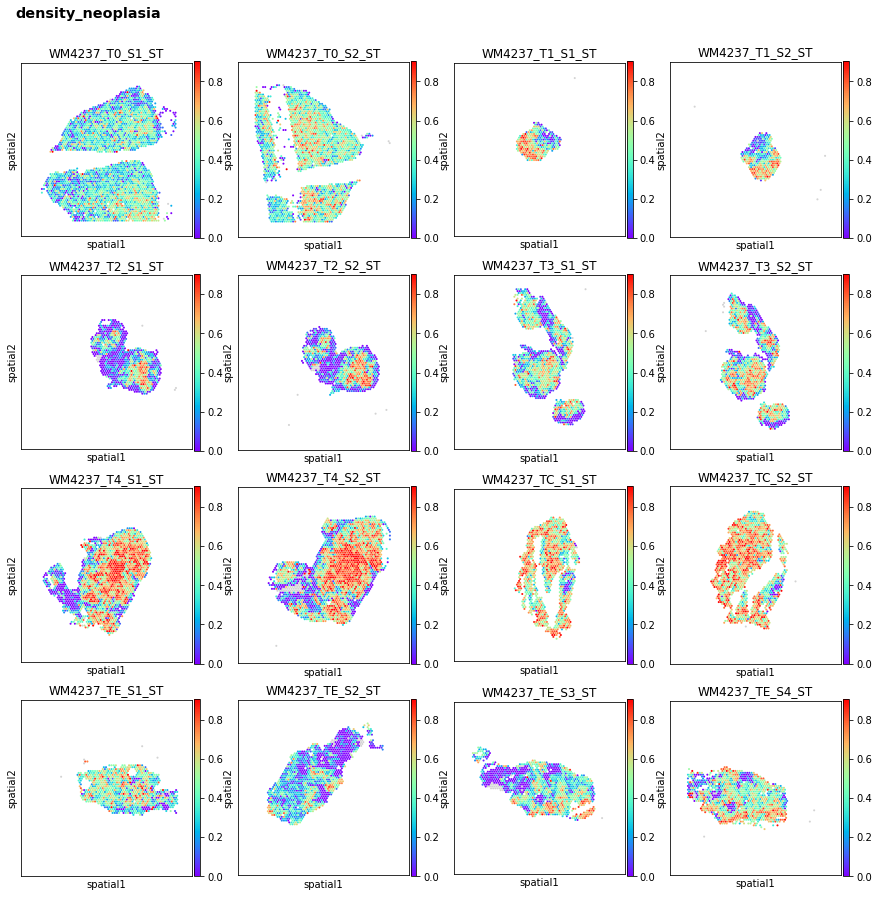

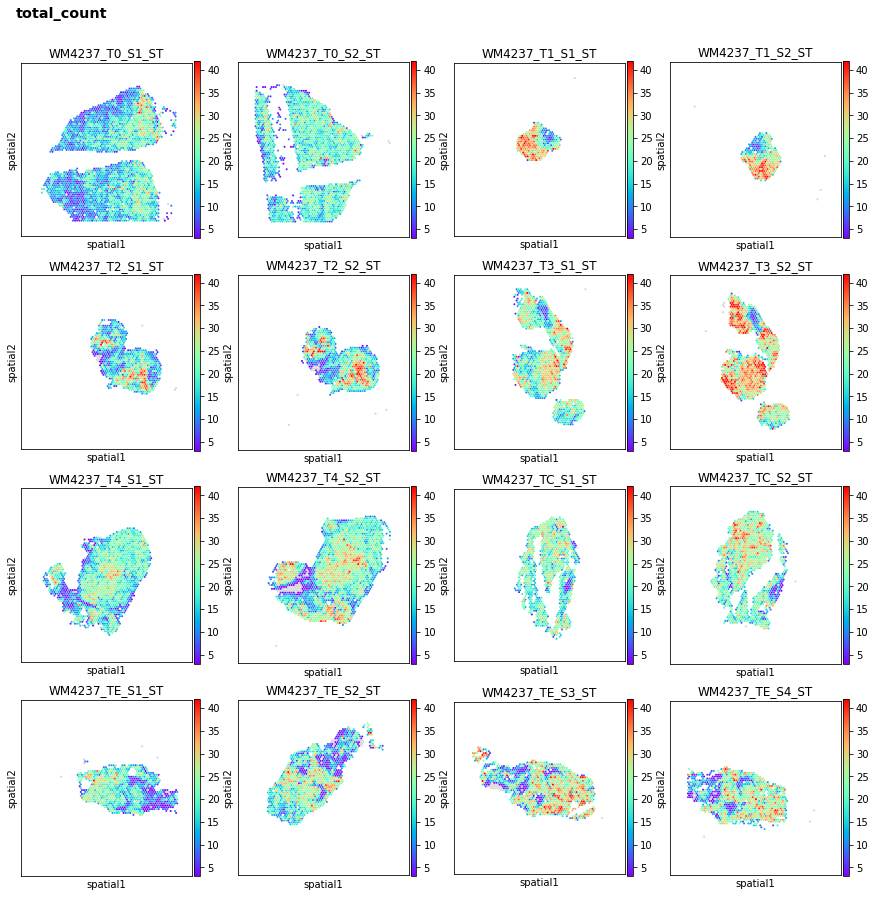

In [29]:
cols_density = cols[cols.str.contains('density') | cols.str.contains('total_count')]
print(cols_density)

for identity in cols_density:
    plotSpatialAll(ads, identity = identity, img_key=None, nx=4, ny=4)

Index(['average_area_neoplasia', 'average_area_connective', 'average_area'], dtype='object')


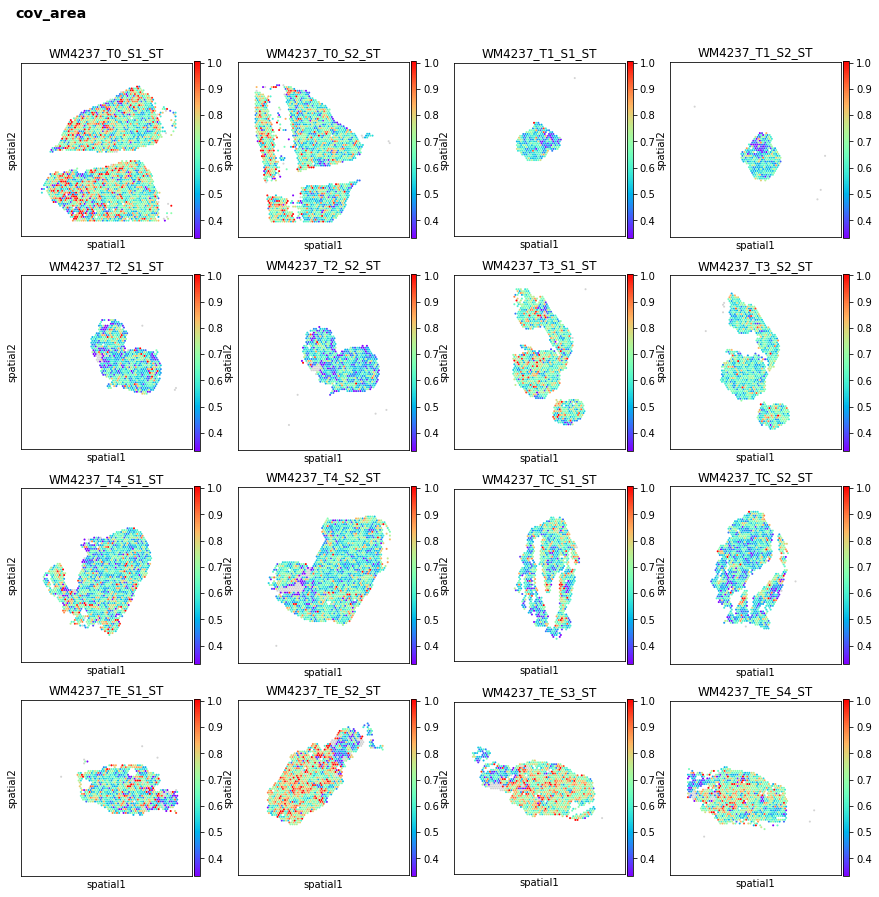

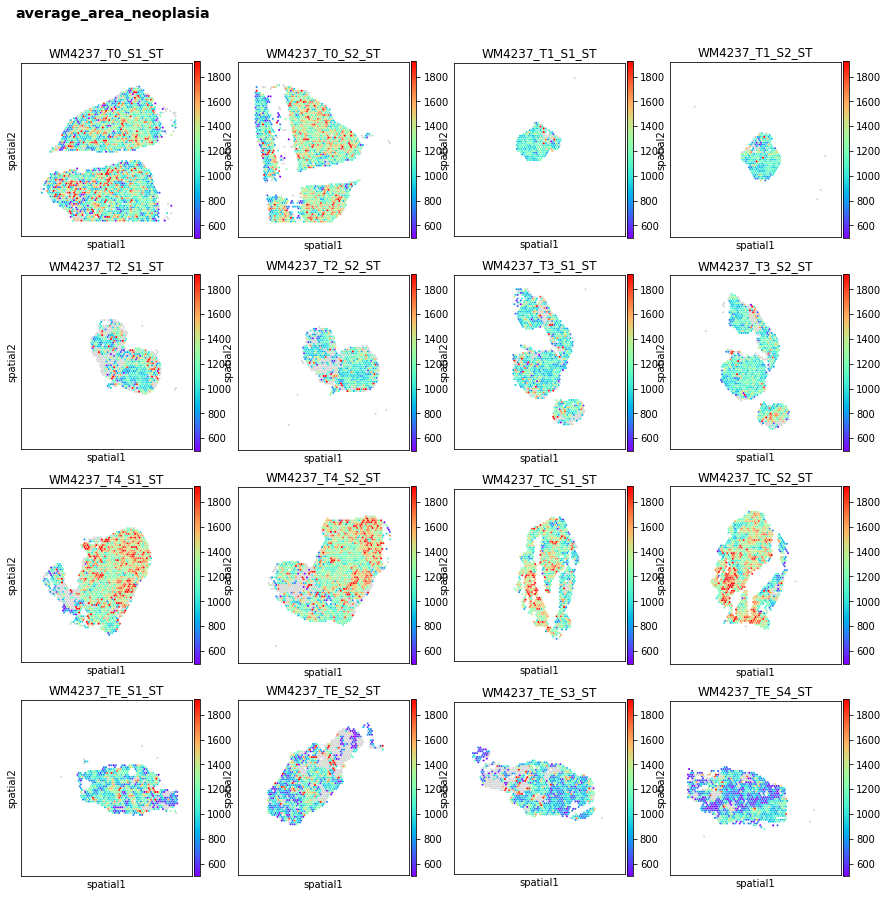

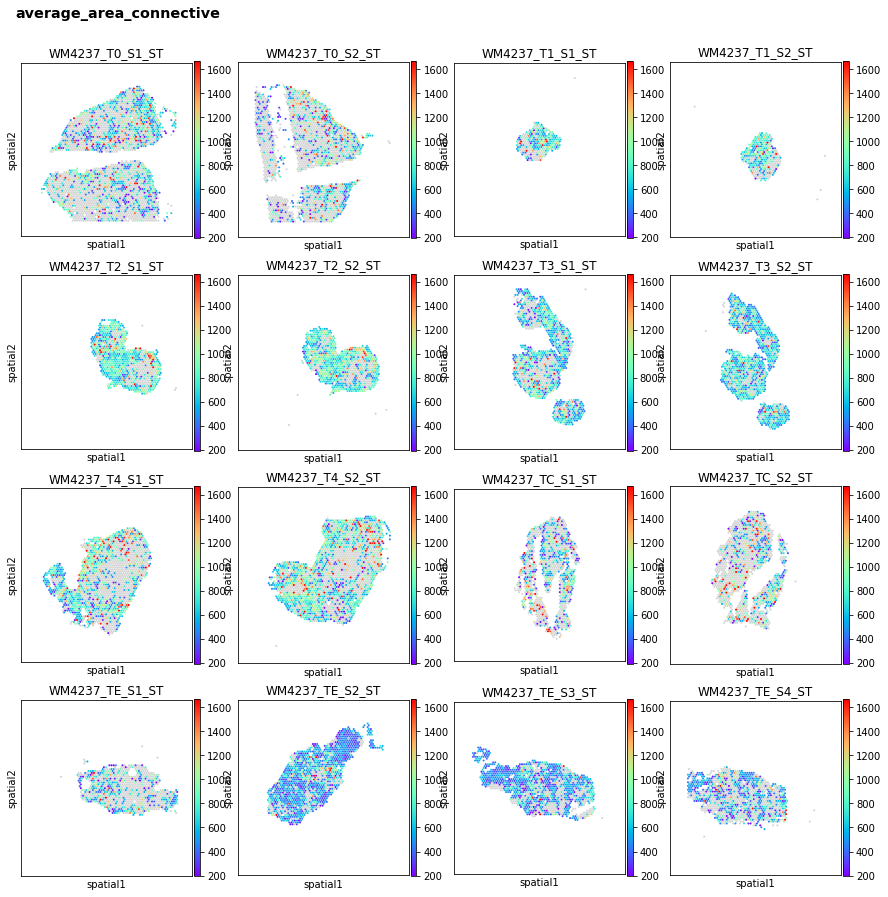

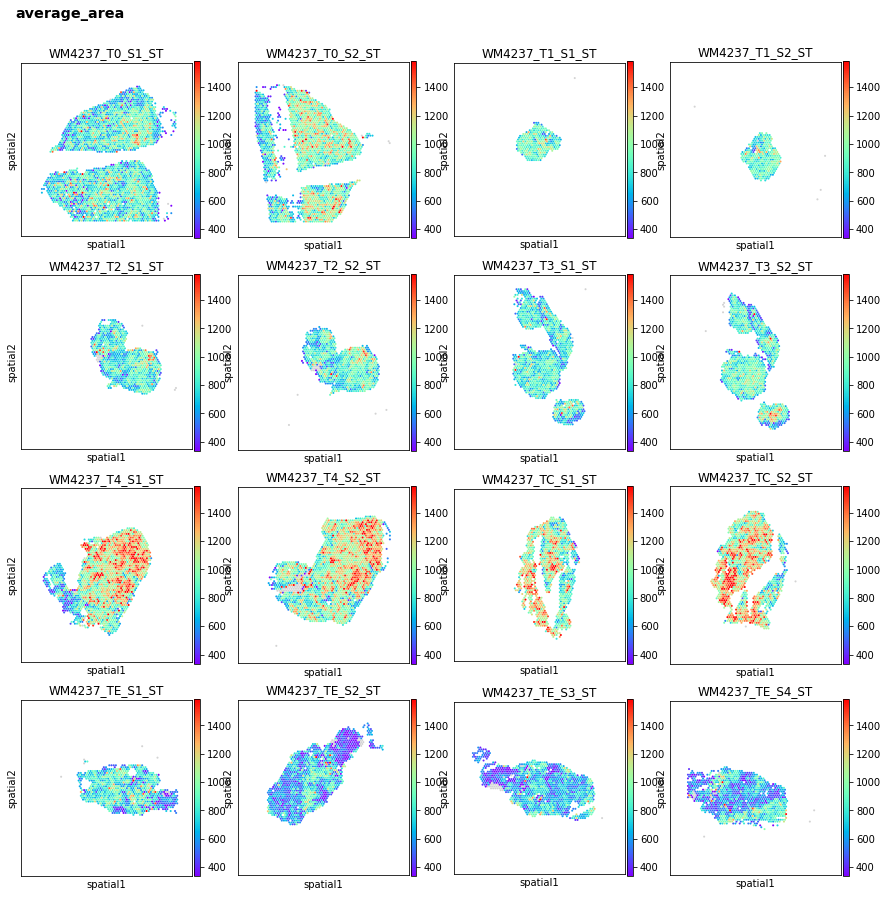

In [30]:
cols_area = cols[cols.str.contains('area') & ~cols.str.contains('std')]
print(cols_area)

plotSpatialAll(ads, identity = 'cov_area', img_key=None, nx=4, ny=4)

for identity in cols_area:
    plotSpatialAll(ads, identity = identity, img_key=None, nx=4, ny=4)

Index(['average_perimeter_length_neoplasia',
       'average_perimeter_length_connective', 'average_perimeter_length'],
      dtype='object')


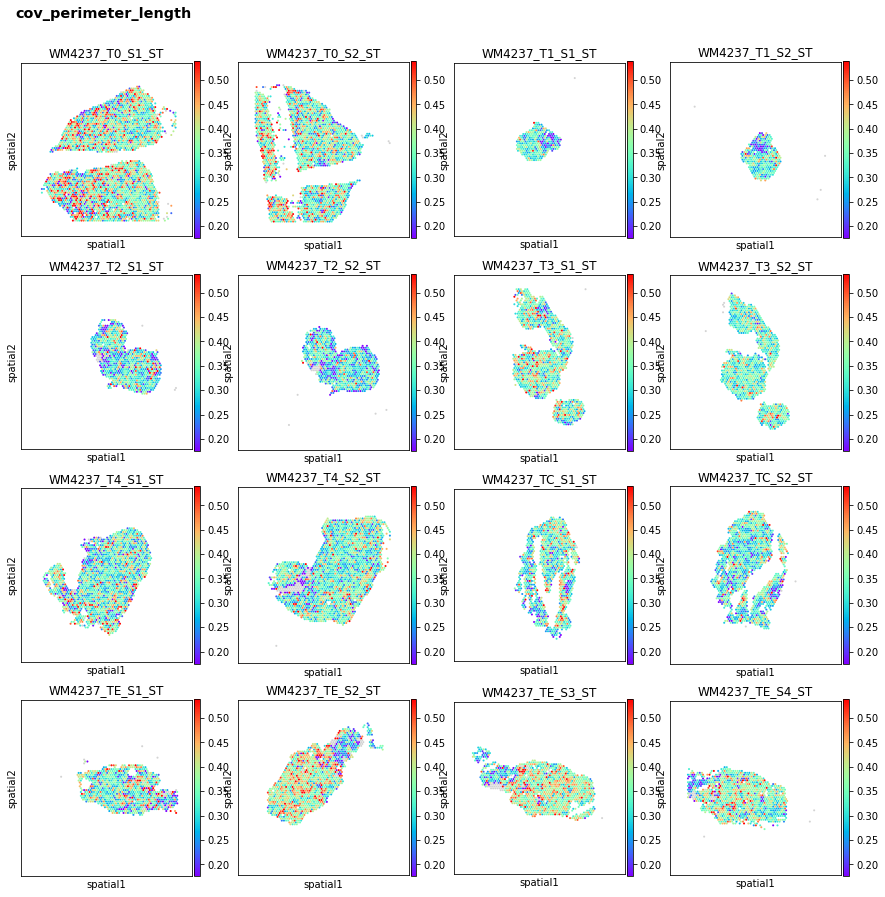

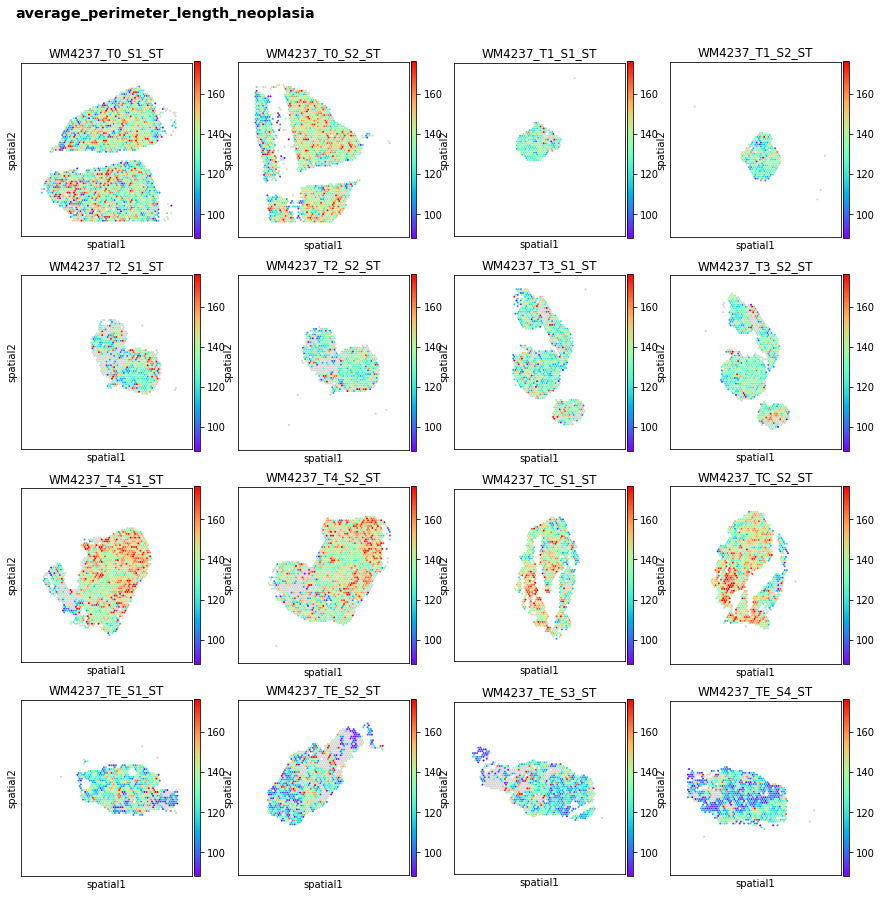

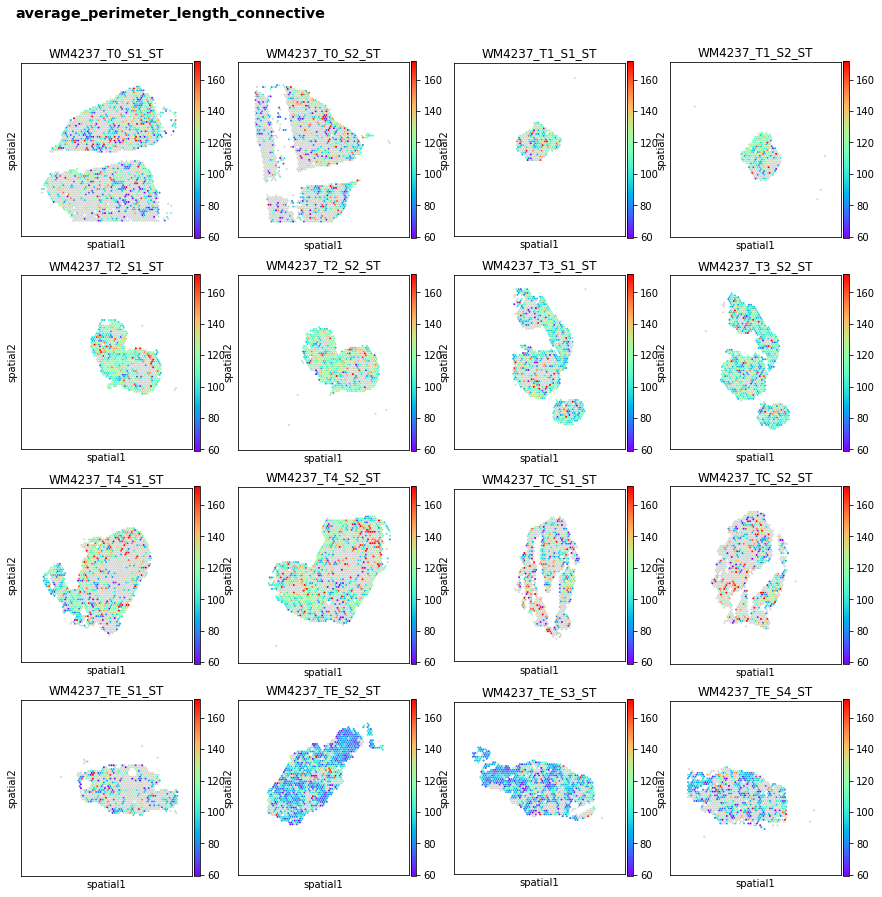

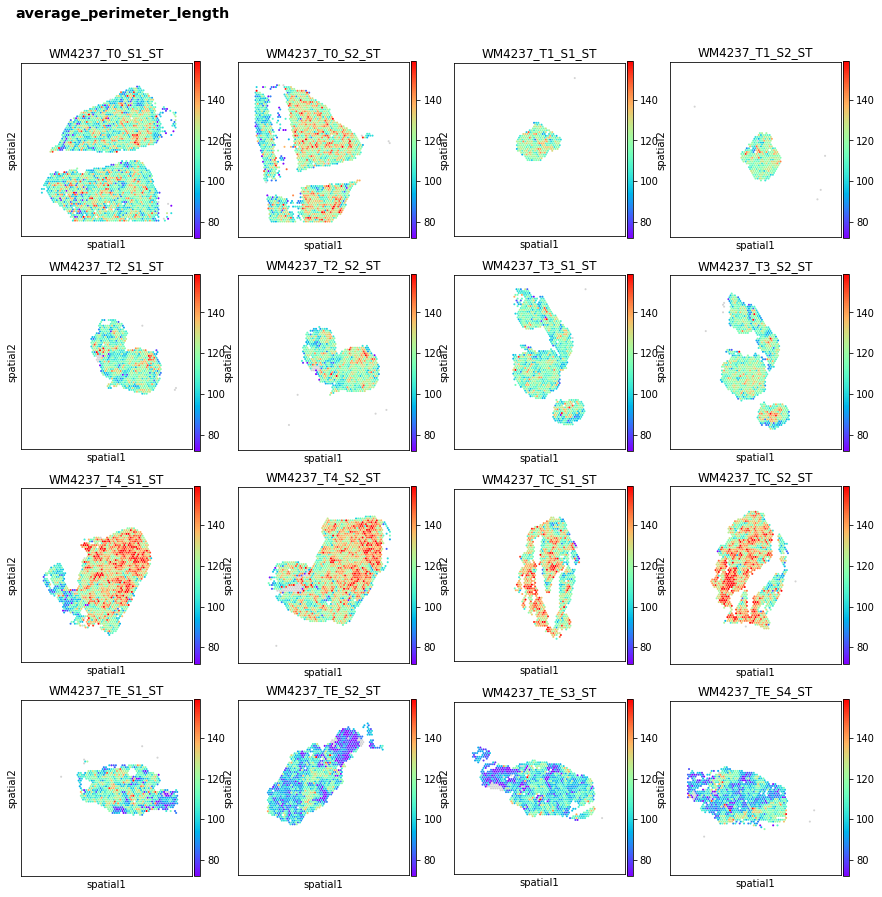

In [31]:
cols_perimeter = cols[cols.str.contains('perimeter_length') & ~cols.str.contains('std')]
print(cols_perimeter)

plotSpatialAll(ads, identity = 'cov_perimeter_length', img_key=None, nx=4, ny=4)

for identity in cols_perimeter:
    plotSpatialAll(ads, identity = identity, img_key=None, nx=4, ny=4)

Index(['average_eccentricity_neoplasia', 'average_eccentricity_connective',
       'average_eccentricity'],
      dtype='object')


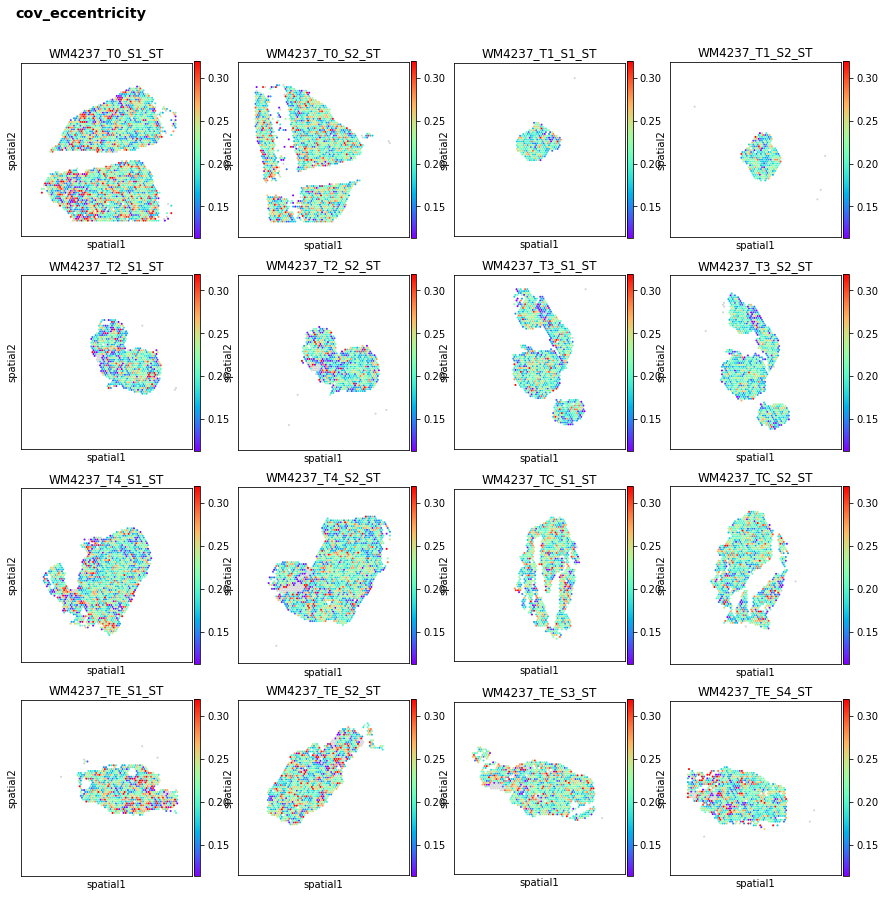

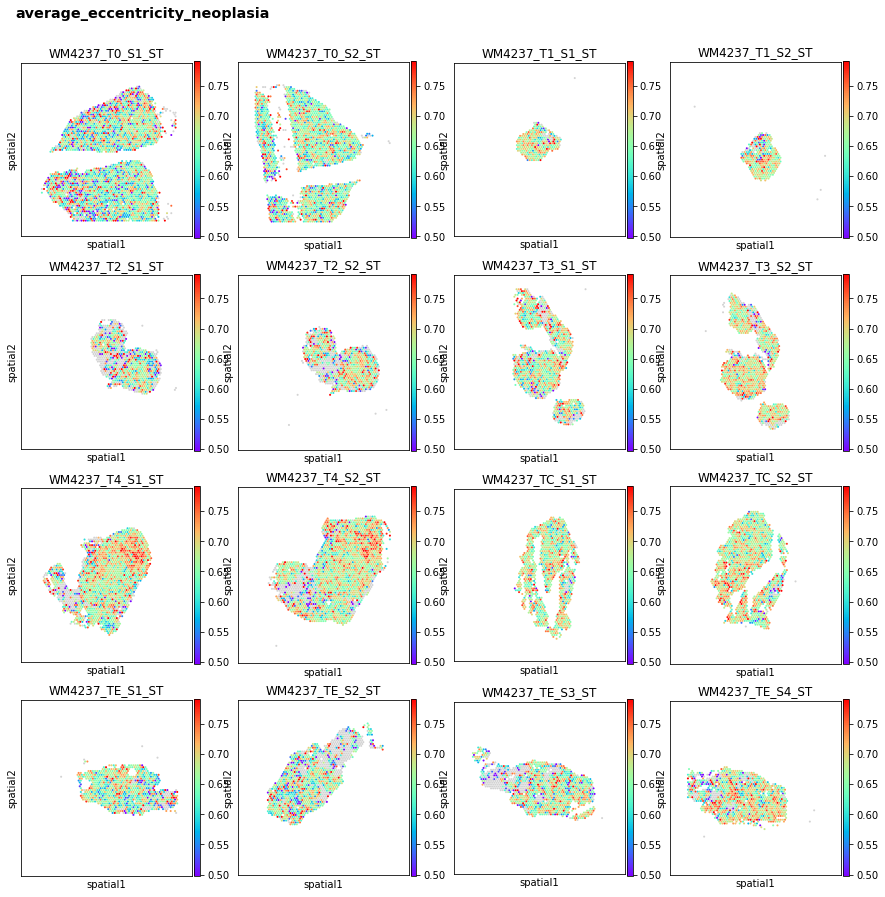

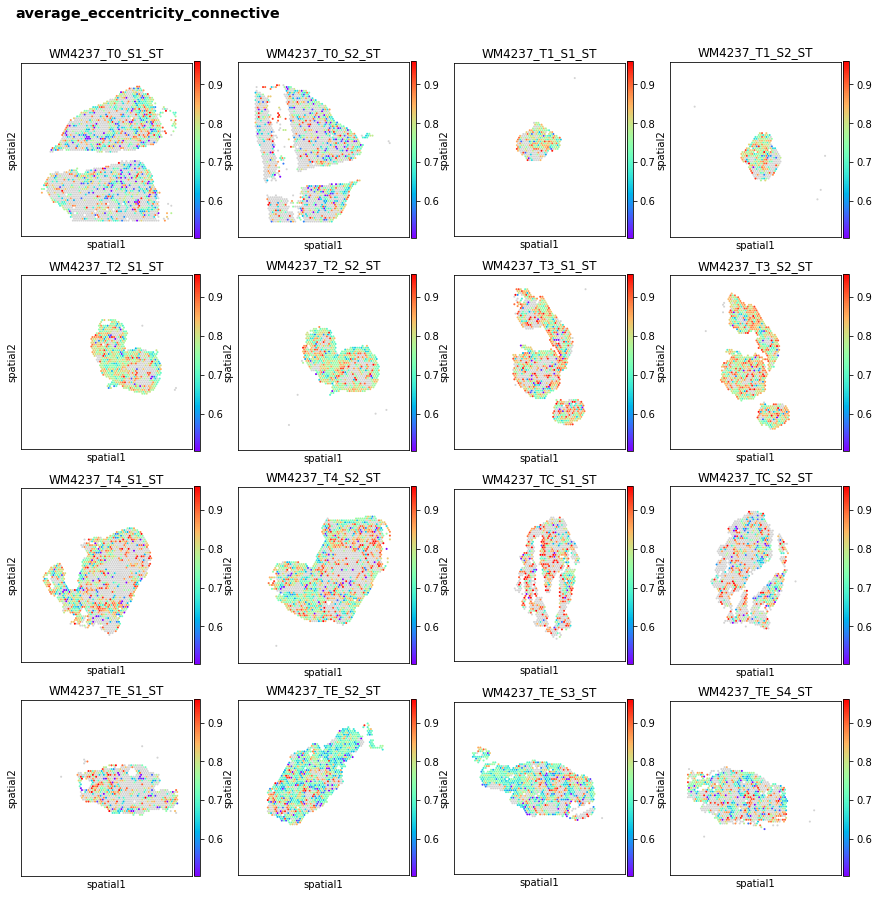

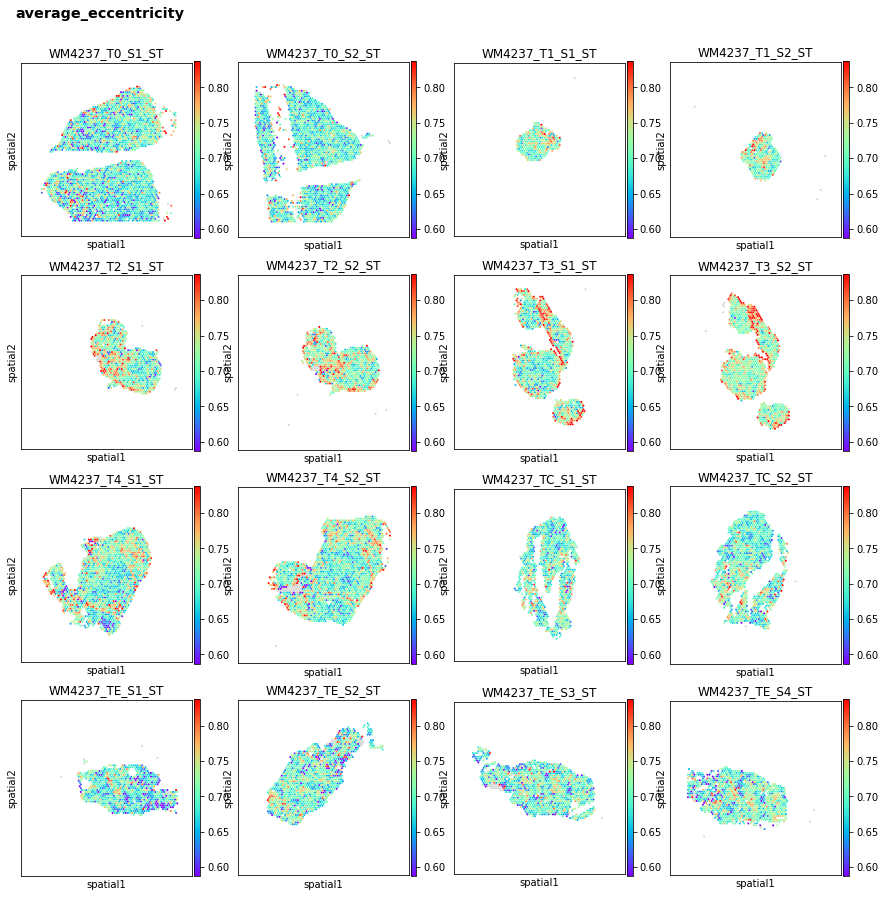

In [32]:
cols_eccentricity = cols[cols.str.contains('eccentricity') & ~cols.str.contains('std')]
print(cols_eccentricity)

plotSpatialAll(ads, identity = 'cov_eccentricity', img_key=None, nx=4, ny=4)

for identity in cols_eccentricity:
    plotSpatialAll(ads, identity = identity, img_key=None, nx=4, ny=4)

Index(['average_orientation_neoplasia', 'average_orientation_connective',
       'average_orientation', 'std_orientation'],
      dtype='object')


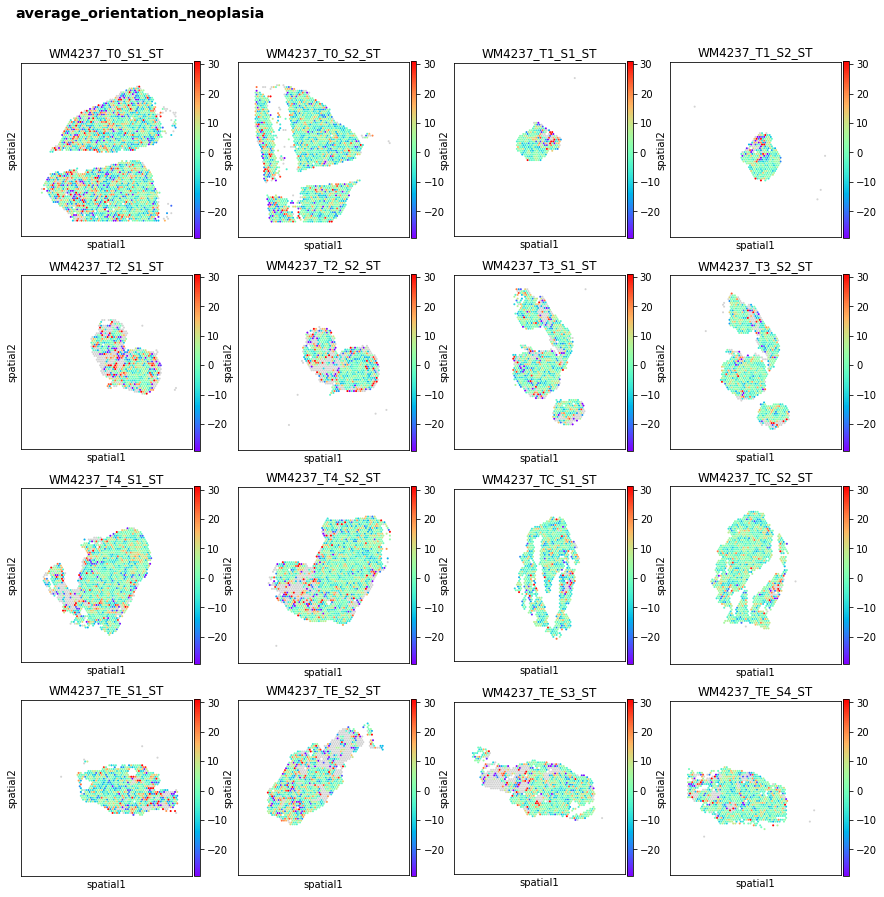

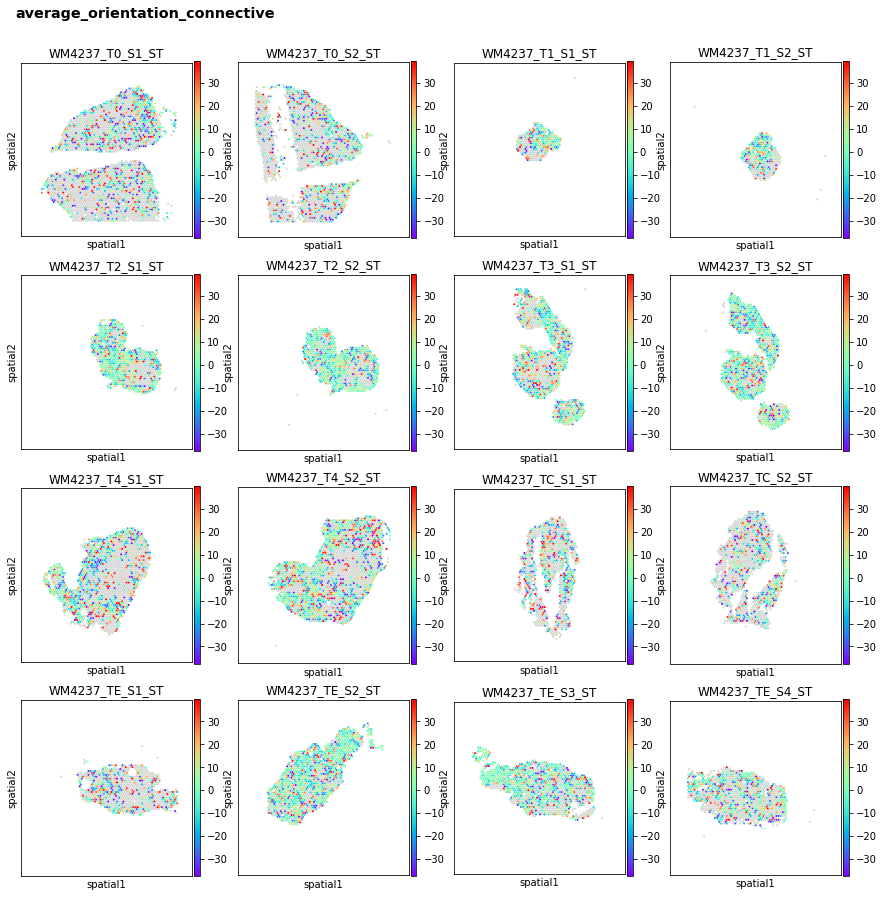

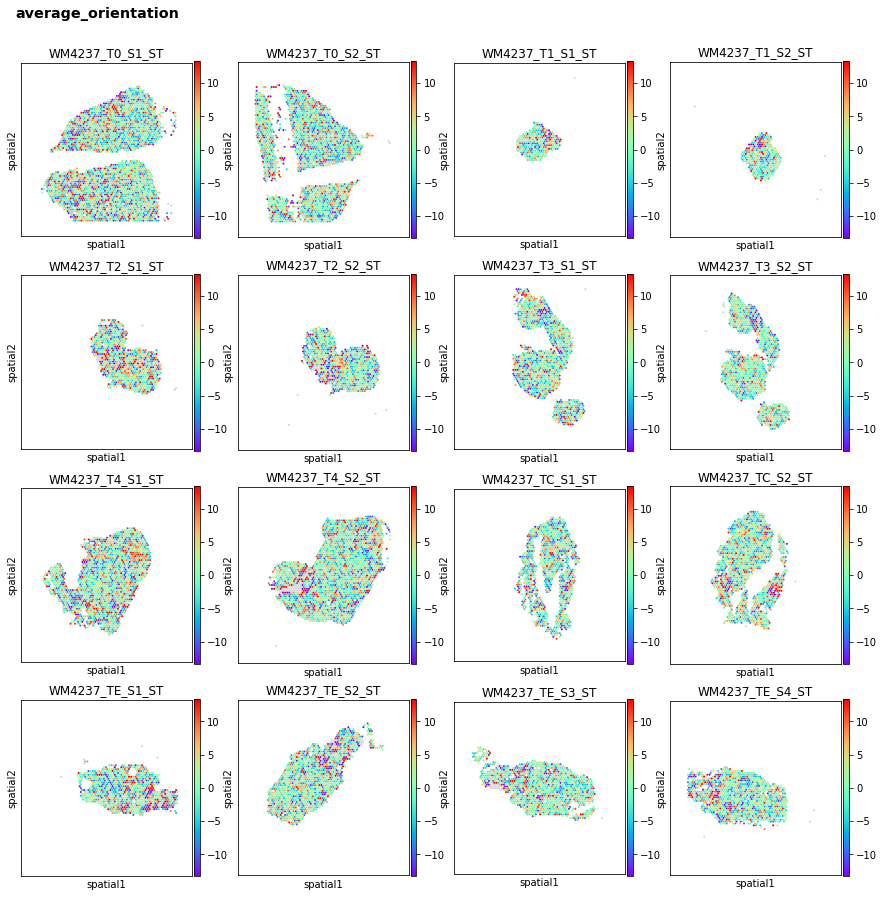

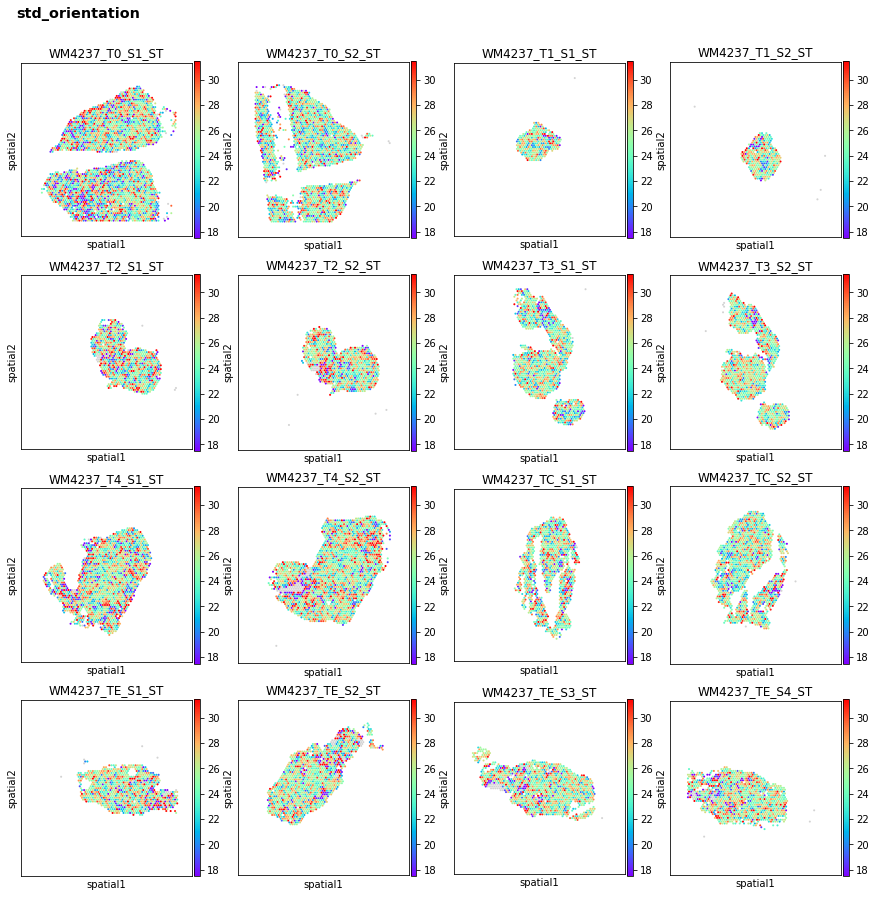

In [33]:
cols_orientation = cols[cols.str.contains('orientation')]
print(cols_orientation)

for identity in cols_orientation:
    plotSpatialAll(ads, identity = identity, img_key=None, nx=4, ny=4)

In [34]:
['density_connective', 'density_neoplasia', 'total_count',
'average_area_neoplasia', 'average_area_connective', 'average_area',
'average_perimeter_length_neoplasia', 'average_perimeter_length_connective', 'average_perimeter_length',
'average_eccentricity_neoplasia', 'average_eccentricity_connective', 'average_eccentricity',
'average_orientation_neoplasia', 'average_orientation_connective', 'average_orientation', 'std_orientation',
'cov_area', 'cov_perimeter_length', 'cov_eccentricity'];